In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import scipy as spy
import copy

# import dataset
df = pd.read_csv("./Datasets/ravdess_features_dm2/RavdessAudioOnlyFeatures_TRAIN.csv", skipinitialspace=True)

In [2]:
df.head()

,modality,vocal_channel,emotion,emotional_intensity,statement,repetition,actor,sex,filename,frame_count,...,stft_max_w4,stft_q01_w4,stft_q05_w4,stft_q25_w4,stft_q50_w4,stft_q75_w4,stft_q95_w4,stft_q99_w4,stft_kur_w4,stft_skew_w4
0,audio-only,speech,neutral,normal,Kids are talking by the door,1st,1,M,03-01-01-01-01-01-01.wav,158558,...,1.0,0.000000,0.566462,0.709962,0.799141,0.896606,1.0,1.0,6.742190,-1.706215
1,audio-only,speech,neutral,normal,Kids are talking by the door,2nd,1,M,03-01-01-01-01-02-01.wav,160160,...,1.0,0.368623,0.472736,0.623183,0.744908,0.874713,1.0,1.0,-0.700420,-0.201495
2,audio-only,speech,neutral,normal,Dogs are sitting by the door,1st,1,M,03-01-01-01-02-01-01.wav,156956,...,1.0,0.000000,0.417919,0.643636,0.774253,0.899156,1.0,1.0,1.688986,-1.024773
3,audio-only,speech,neutral,normal,Dogs are sitting by the door,2nd,1,M,03-01-01-01-02-02-01.wav,152152,...,1.0,0.306280,0.399641,0.606910,0.755213,0.886474,1.0,1.0,-0.594111,-0.412871
4,audio-only,speech,calm,normal,Kids are talking by the door,1st,1,M,03-01-02-01-01-01-01.wav,169769,...,1.0,0.248765,0.428202,0.634815,0.759914,0.878014,1.0,1.0,0.126535,-0.620782


In [3]:
df1=copy.deepcopy(df)

In [4]:
df1

,modality,vocal_channel,emotion,emotional_intensity,statement,repetition,actor,sex,filename,frame_count,...,stft_max_w4,stft_q01_w4,stft_q05_w4,stft_q25_w4,stft_q50_w4,stft_q75_w4,stft_q95_w4,stft_q99_w4,stft_kur_w4,stft_skew_w4
0,audio-only,speech,neutral,normal,Kids are talking by the door,1st,1,M,03-01-01-01-01-01-01.wav,158558,...,1.0,0.000000,0.566462,0.709962,0.799141,0.896606,1.0,1.0,6.742190,-1.706215
1,audio-only,speech,neutral,normal,Kids are talking by the door,2nd,1,M,03-01-01-01-01-02-01.wav,160160,...,1.0,0.368623,0.472736,0.623183,0.744908,0.874713,1.0,1.0,-0.700420,-0.201495
2,audio-only,speech,neutral,normal,Dogs are sitting by the door,1st,1,M,03-01-01-01-02-01-01.wav,156956,...,1.0,0.000000,0.417919,0.643636,0.774253,0.899156,1.0,1.0,1.688986,-1.024773
3,audio-only,speech,neutral,normal,Dogs are sitting by the door,2nd,1,M,03-01-01-01-02-02-01.wav,152152,...,1.0,0.306280,0.399641,0.606910,0.755213,0.886474,1.0,1.0,-0.594111,-0.412871
4,audio-only,speech,calm,normal,Kids are talking by the door,1st,1,M,03-01-02-01-01-01-01.wav,169769,...,1.0,0.248765,0.428202,0.634815,0.759914,0.878014,1.0,1.0,0.126535,-0.620782
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1823,audio-only,speech,surprised,normal,Dogs are sitting by the door,2nd,18,F,03-01-08-01-02-02-18.wav,168168,...,1.0,0.000000,0.000000,0.542632,0.728154,0.893268,1.0,1.0,0.262900,-1.051814
1824,audio-only,speech,surprised,strong,Kids are talking by the door,1st,18,F,03-01-08-02-01-01-18.wav,174575,...,1.0,0.000000,0.000000,0.375423,0.702983,0.900089,1.0,1.0,-0.857759,-0.608583
1825,audio-only,speech,surprised,strong,Kids are talking by the door,2nd,18,F,03-01-08-02-01-02-18.wav,169770,...,1.0,0.000000,0.097608,0.446789,0.686781,0.891486,1.0,1.0,-0.656632,-0.586954
1826,audio-only,speech,surprised,strong,Dogs are sitting by the door,1st,18,F,03-01-08-02-02-01-18.wav,185786,...,1.0,0.000000,0.000000,0.484284,0.712452,0.869563,1.0,1.0,-0.499022,-0.849045


<h3>Inital Pre-processing</h3>

In [4]:
df1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1828 entries, 0 to 1827
Columns: 434 entries, modality to stft_skew_w4
dtypes: float64(405), int64(21), object(8)
memory usage: 6.1+ MB


In [5]:
df1.describe(include="all").T

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
modality,1828,1,audio-only,1828,NaN,NaN,NaN,NaN,NaN,NaN,NaN
vocal_channel,1828,2,speech,1080,NaN,NaN,NaN,NaN,NaN,NaN,NaN
emotion,1828,8,calm,280,NaN,NaN,NaN,NaN,NaN,NaN,NaN
emotional_intensity,1828,2,normal,984,NaN,NaN,NaN,NaN,NaN,NaN,NaN
statement,1828,2,Kids are talking by the door,914,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...
stft_q75_w4,1828.0,NaN,NaN,NaN,0.842724,0.07809,0.007891,0.812227,0.85509,0.889619,0.986704
stft_q95_w4,1828.0,NaN,NaN,NaN,0.999818,0.005041,0.839625,1.0,1.0,1.0,1.0
stft_q99_w4,1828.0,NaN,NaN,NaN,1.0,0.0,1.0,1.0,1.0,1.0,1.0
stft_kur_w4,1828.0,NaN,NaN,NaN,-0.555631,0.776547,-1.64432,-1.007945,-0.745296,-0.316342,7.127631


In [6]:
## Conteggio dei valori mancanti e dei valori nulli
nv = df1.columns[df.isnull().any()]
print('Null values = ', nv)

mv = df1.columns[df.isna().any()]
print('Missing values = ', mv)

Null values =  Index([], dtype='object')
Missing values =  Index([], dtype='object')


Non ci sono valori nulli o mancanti

In [7]:
#rimozione duplicati del dataframe
print("Shape: ", df1.shape)
df1_dup=df1.copy()
df1_dup.drop_duplicates(inplace=True)
print("New shape after having removed duplicates: ",df1_dup.shape)

Shape:  (1828, 434)
New shape after having removed duplicates:  (1828, 434)


Non ci sono valori duplicati

In [8]:
listcolumns=[] #listcolumns is a list of all the columns
for columns in df1:
    listcolumns.append(columns)
#print(listcolumns)

<h3>Eliminazione variabili a valori costanti</h3>

In [9]:
df2=copy.deepcopy(df1)

In [40]:
#Creo una lista listUniqueValuesColumns

uniqueValues=[]
listUniqueValuesColumns=[]
for i in listcolumns:
    uniqueValues = (i,df2[i].nunique()) 
    if uniqueValues==(i,1):
        #print(uniqueValues)
        listUniqueValuesColumns.append(i)
print(listUniqueValuesColumns)
print(len(listUniqueValuesColumns)) #ci sono 52 colonne con valori tutti uguali


['modality', 'lag1_q50', 'zc_min', 'zc_max', 'zc_q01', 'zc_q05', 'zc_q25', 'zc_q50', 'zc_q75', 'zc_q99', 'stft_max', 'stft_q95', 'stft_q99', 'lag1_q50_w1', 'zc_min_w1', 'zc_max_w1', 'zc_q01_w1', 'zc_q05_w1', 'zc_q25_w1', 'zc_q50_w1', 'zc_q75_w1', 'zc_min_w2', 'zc_max_w2', 'zc_q01_w2', 'zc_q05_w2', 'zc_q25_w2', 'zc_q50_w2', 'zc_q75_w2', 'zc_q99_w2', 'stft_max_w2', 'stft_q95_w2', 'stft_q99_w2', 'zc_min_w3', 'zc_max_w3', 'zc_q01_w3', 'zc_q05_w3', 'zc_q25_w3', 'zc_q50_w3', 'zc_q75_w3', 'zc_q99_w3', 'stft_max_w3', 'stft_q95_w3', 'stft_q99_w3', 'lag1_q50_w4', 'zc_min_w4', 'zc_max_w4', 'zc_q01_w4', 'zc_q05_w4', 'zc_q25_w4', 'zc_q50_w4', 'stft_max_w4', 'stft_q99_w4']
52


La lista qui sopra è la lista delle colonne che hanno tutti i valori uguali ad ogni riga. <br/>
Visto che i valori sono sempre uguali possiamo dropparle

In [41]:
df2 = df2.drop(listUniqueValuesColumns,axis=1)

In [42]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1828 entries, 0 to 1827
Columns: 382 entries, vocal_channel to stft_skew_w4
dtypes: float64(364), int64(11), object(7)
memory usage: 5.3+ MB


In [43]:
df2.shape #rimangono 382 colonne --> ne ho eliminate 52

(1828, 382)

<h3>Correlazione e eliminazione variabili altamente correlate</h3>

In [44]:
#matrice di correlazione utilizzando PEARSON
corr_matrix = df2.corr(method="pearson").style.background_gradient(cmap='coolwarm', vmin=-1, vmax=1)
corr_matrix 

In [45]:
#matrice di correlazione utilizzando SPEARMAN
df2.corr(method="spearman").style.background_gradient(cmap='coolwarm', vmin=-1, vmax=1)

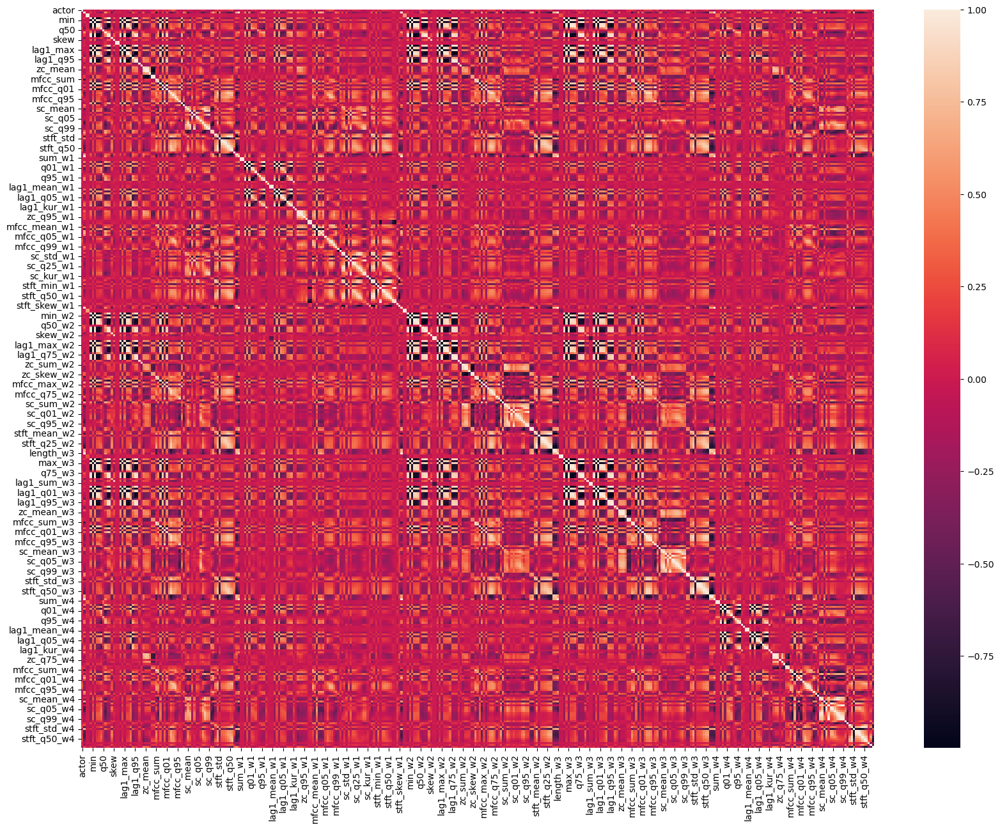

In [46]:
# plotting and displaying correlation heatmap PEARSON
plt.figure(figsize=(20,15))
dataplot = sns.heatmap(df2.corr(method="pearson"), annot=False)
plt.show()

In [47]:
cor_matrix = df2.corr(method="spearman").abs()
print(cor_matrix)

                 actor  frame_count       sum      mean       std       min  \
actor         1.000000     0.106476  0.034820  0.036677  0.022985  0.029226   
frame_count   0.106476     1.000000  0.013979  0.028631  0.321312  0.192729   
sum           0.034820     0.013979  1.000000  0.998879  0.140022  0.135247   
mean          0.036677     0.028631  0.998879  1.000000  0.141712  0.135069   
std           0.022985     0.321312  0.140022  0.141712  1.000000  0.962940   
...                ...          ...       ...       ...       ...       ...   
stft_q50_w4   0.213686     0.475036  0.035632  0.043414  0.304667  0.233241   
stft_q75_w4   0.229314     0.373075  0.065508  0.071714  0.249142  0.192949   
stft_q95_w4   0.035025     0.046336  0.039002  0.033520  0.018196  0.026105   
stft_kur_w4   0.144806     0.412965  0.018964  0.025208  0.193731  0.126690   
stft_skew_w4  0.187638     0.129164  0.038136  0.040411  0.154681  0.146630   

                   max       q01       q05       q2

In [49]:
upper_tri = cor_matrix.where(np.triu(np.ones(cor_matrix.shape),k=1).astype(np.bool))
print(upper_tri)

#we select the upper triangular of the matrix



              actor  frame_count       sum      mean       std       min  \
actor           NaN     0.106476  0.034820  0.036677  0.022985  0.029226   
frame_count     NaN          NaN  0.013979  0.028631  0.321312  0.192729   
sum             NaN          NaN       NaN  0.998879  0.140022  0.135247   
mean            NaN          NaN       NaN       NaN  0.141712  0.135069   
std             NaN          NaN       NaN       NaN       NaN  0.962940   
...             ...          ...       ...       ...       ...       ...   
stft_q50_w4     NaN          NaN       NaN       NaN       NaN       NaN   
stft_q75_w4     NaN          NaN       NaN       NaN       NaN       NaN   
stft_q95_w4     NaN          NaN       NaN       NaN       NaN       NaN   
stft_kur_w4     NaN          NaN       NaN       NaN       NaN       NaN   
stft_skew_w4    NaN          NaN       NaN       NaN       NaN       NaN   

                   max       q01       q05       q25  ...  stft_std_w4  \
actor        

/var/folders/q8/kft2ssqs16q86dkk4gf4n3100000gn/T/ipykernel_2353/3432253603.py:1: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  upper_tri = cor_matrix.where(np.triu(np.ones(cor_matrix.shape),k=1).astype(np.bool))


In [51]:
to_drop = [column for column in upper_tri.columns if any(upper_tri[column] > 0.95)] #salvo in una lista le colonne con correlazione maggiore di 0.95
print()
print(to_drop)


['mean', 'min', 'max', 'q01', 'q05', 'q95', 'q99', 'lag1_mean', 'lag1_min', 'lag1_max', 'lag1_q01', 'lag1_q05', 'lag1_q95', 'lag1_q99', 'zc_std', 'zc_kur', 'zc_skew', 'mfcc_std', 'mfcc_min', 'mfcc_q01', 'stft_q50', 'stft_skew', 'length_w1', 'mean_w1', 'min_w1', 'max_w1', 'q01_w1', 'q95_w1', 'q99_w1', 'lag1_mean_w1', 'lag1_std_w1', 'lag1_max_w1', 'lag1_q01_w1', 'lag1_q75_w1', 'lag1_q95_w1', 'lag1_q99_w1', 'zc_mean_w1', 'zc_std_w1', 'zc_kur_w1', 'zc_skew_w1', 'mfcc_q01_w1', 'sc_q01_w1', 'sc_q99_w1', 'stft_q01_w1', 'stft_q25_w1', 'stft_q50_w1', 'length_w2', 'mean_w2', 'std_w2', 'min_w2', 'max_w2', 'q01_w2', 'q05_w2', 'q25_w2', 'q75_w2', 'q95_w2', 'q99_w2', 'lag1_mean_w2', 'lag1_std_w2', 'lag1_min_w2', 'lag1_max_w2', 'lag1_q01_w2', 'lag1_q05_w2', 'lag1_q25_w2', 'lag1_q75_w2', 'lag1_q95_w2', 'lag1_q99_w2', 'zc_std_w2', 'zc_kur_w2', 'zc_skew_w2', 'mfcc_std_w2', 'sc_q01_w2', 'sc_q99_w2', 'stft_q01_w2', 'stft_q05_w2', 'stft_q25_w2', 'stft_q50_w2', 'stft_q75_w2', 'stft_kur_w2', 'stft_skew_w2',

In [54]:
df3=copy.deepcopy(df2)
df3 = df3.drop(to_drop,axis=1)
#df3 = df3.drop(df3.columns[to_drop], axis=1)
print()
print(df3.head())


  vocal_channel  emotion emotional_intensity                     statement  \
0        speech  neutral              normal  Kids are talking by the door   
1        speech  neutral              normal  Kids are talking by the door   
2        speech  neutral              normal  Dogs are sitting by the door   
3        speech  neutral              normal  Dogs are sitting by the door   
4        speech     calm              normal  Kids are talking by the door   

  repetition  actor sex                  filename  frame_count       sum  ...  \
0        1st      1   M  03-01-01-01-01-01-01.wav       158558  0.145081  ...   
1        2nd      1   M  03-01-01-01-01-02-01.wav       160160  0.114319  ...   
2        1st      1   M  03-01-01-01-02-01-01.wav       156956  0.149963  ...   
3        2nd      1   M  03-01-01-01-02-02-01.wav       152152  0.139618  ...   
4        1st      1   M  03-01-02-01-01-01-01.wav       169769  0.137665  ...   

   sc_kur_w4  sc_skew_w4  stft_sum_w4  stft

In [55]:
df3 = df3.drop(['actor','filename'],axis=1)

df: dataframe originale <br/>
df1: quello su cui ho fatto il controllo dei duplicati e valori nulli<br/>
df2: quello da cui ho eliminato le colonne tutte uguali <br/>
df3: quello da cui ho eliminato le colonne altamente correlate <br/>

In [56]:
# visualizzo nuovamente matrice di correlazione con pearson
df3.corr(method="pearson").style.background_gradient(cmap='coolwarm', vmin=-1, vmax=1)

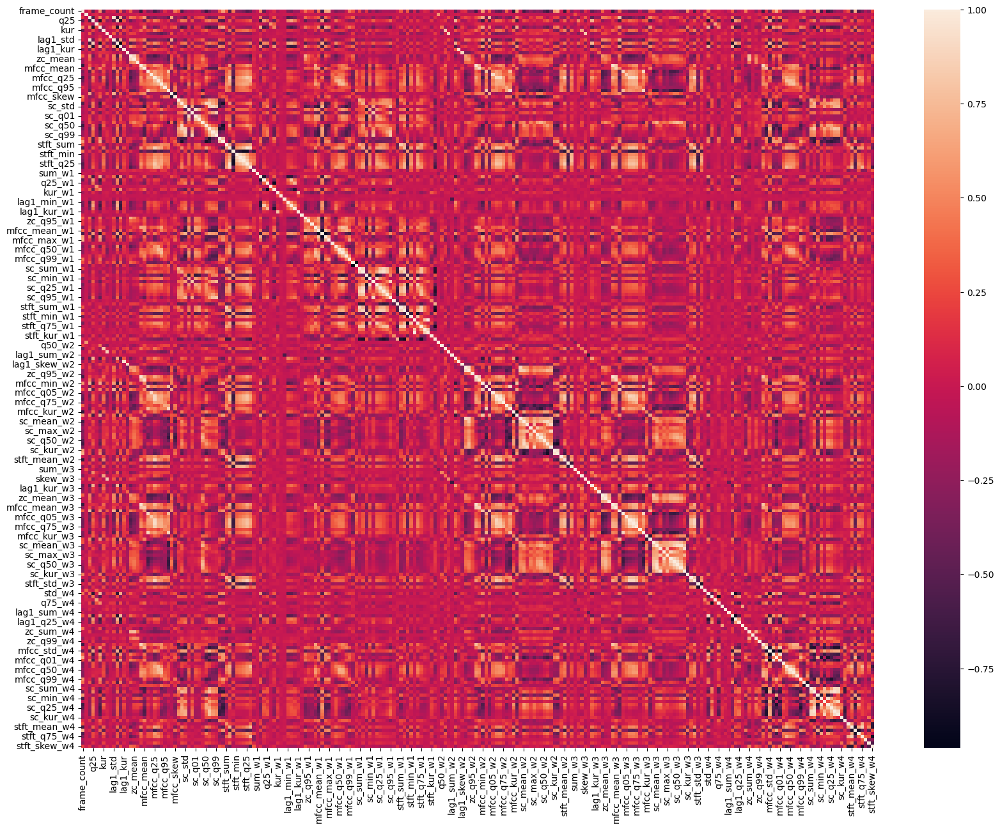

In [57]:
#visualizzo con mappa di calore e pearson
plt.figure(figsize=(20,15))
dataplot = sns.heatmap(df3.corr(method="pearson"), annot=False)
plt.show()

In [58]:
# Creazione di un nuovo file. csv dopo aver eseguito le operazioni di pre Preprocessing sui dati

# !! eseguire 1 VOLTA e poi commentare per non creare il file .csv tutte le volte, a meno di modifiche da apportare !!

#df3.to_csv('./Datasets/ravdess_features_dm2/InitialPreProcessedDataSet.csv')